In [ ]:
!git clone https://github.com/Karanraj06/image-compression.git



Cloning into 'image-compression'...
remote: Enumerating objects: 68, done.
remote: Counting objects: 100% (68/68), done.
remote: Compressing objects: 100% (63/63), done.
remote: Total 68 (delta 11), reused 56 (delta 4), pack-reused 0
Receiving objects: 100% (68/68), 17.34 MiB | 6.91 MiB/s, done.
Resolving deltas: 100% (11/11), done.


Analyze all images in a folder (y/n): y
Enter the path to the images folder: /content/image-compression/images/colored
Enter the block size (even): 8
Enter the number of coefficients passed: 10
Are the images color (y/n): y


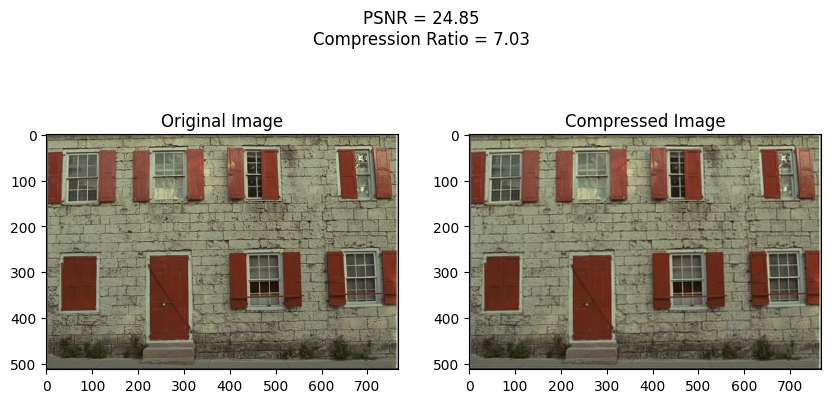

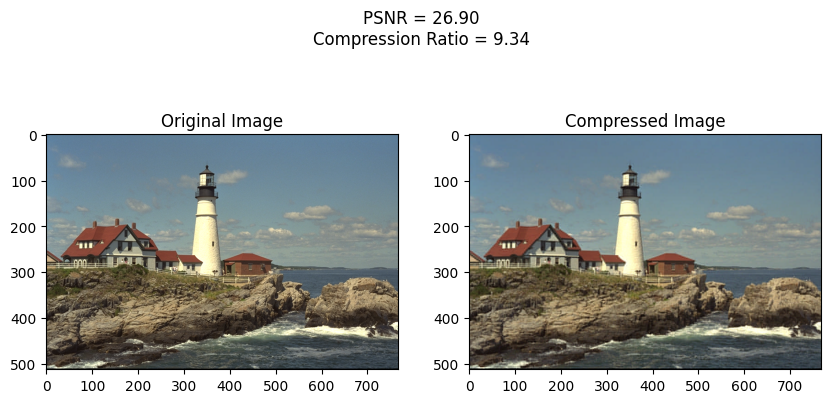

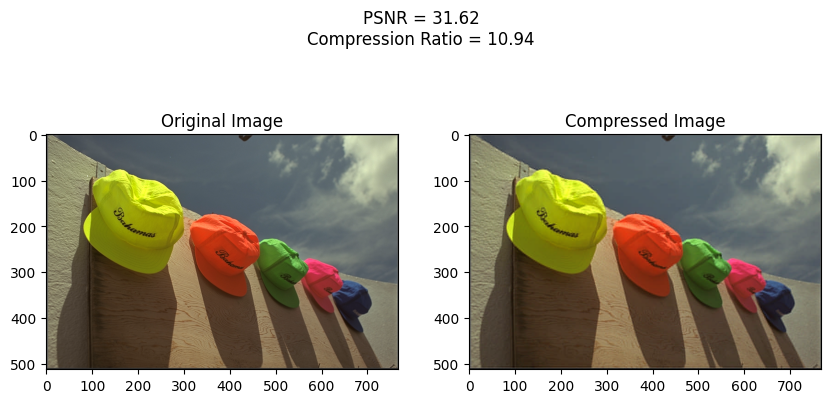

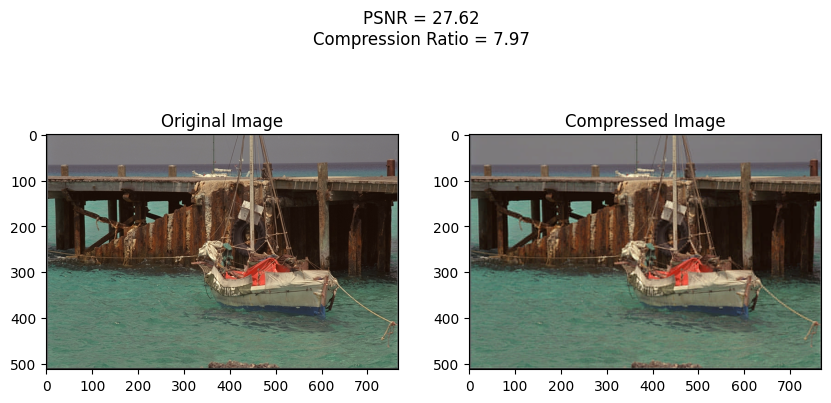

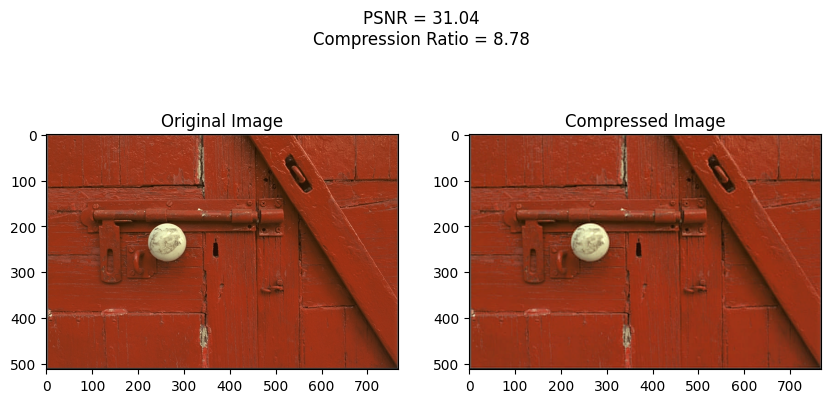

...

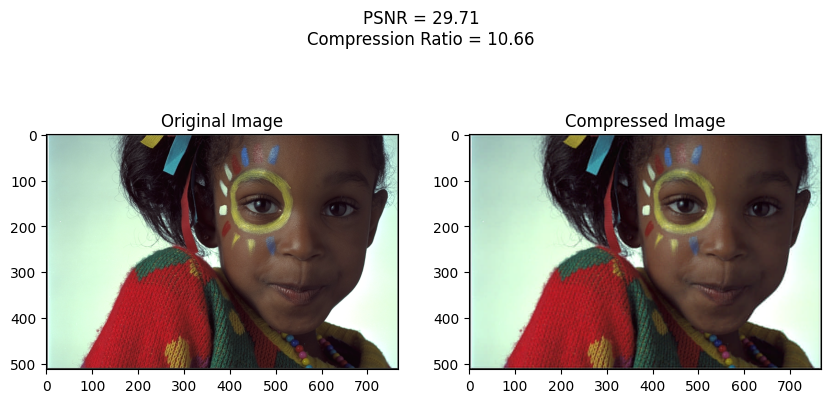

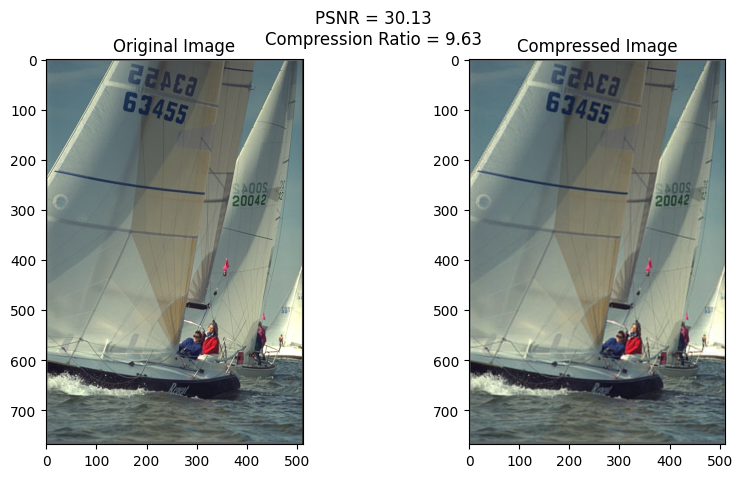

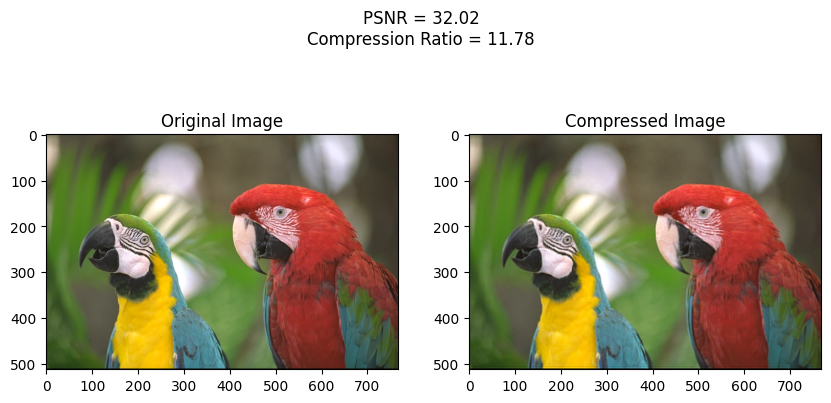

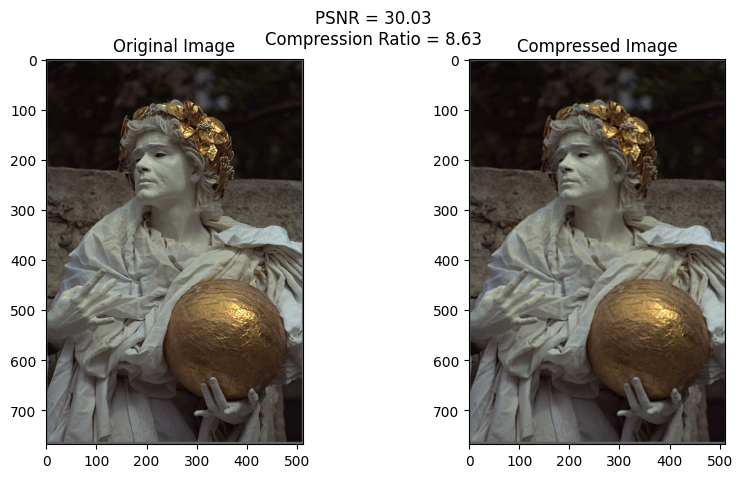

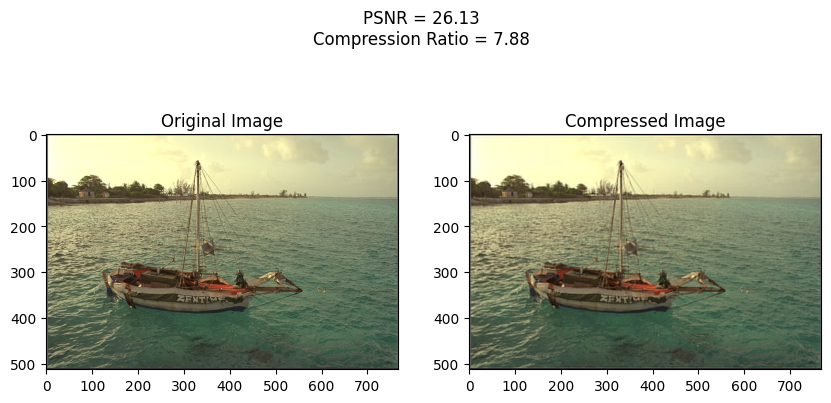

In [8]:
# Import the required modules
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np
import os

# Define the quantization matrix
quantization_matrix = np.array(
    [
        [16, 11, 10, 16, 24, 40, 51, 61],
        [12, 12, 14, 19, 26, 58, 60, 55],
        [14, 13, 16, 24, 40, 57, 69, 56],
        [14, 17, 22, 29, 51, 87, 80, 62],
        [18, 22, 37, 56, 68, 109, 103, 77],
        [24, 35, 55, 64, 81, 104, 113, 92],
        [49, 64, 78, 87, 103, 121, 120, 101],
        [72, 92, 95, 98, 112, 100, 103, 99],
    ],
    dtype=np.float32,
)


def calculate_psnr(img1: np.ndarray[np.uint8], img2: np.ndarray[np.uint8]) -> float:
    """Calculate PSNR using formula: PSNR = 20 * log10(MAX_I) - 10 * log10(MSE)"""
    mse = np.mean((img1 - img2) ** 2)
    psnr = 20 * np.log10(255 / np.sqrt(mse))
    return psnr


def number_of_elements(blocks: list[np.ndarray[np.int32]]) -> int:
    """Calculates the total number of elements in the grayscale JPEG encoded array"""
    total_elements = 0
    for block in blocks:
        # Trim the trailing zeros from the 1D array
        total_elements += np.trim_zeros(block, "b").size
    return total_elements


def total_number_of_elements(
    blocks: list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    color: bool,
) -> int:
    """
    Calculates the total number of elements for both color and grayscale JPEG encoded arrays
    This is a utility function that will be used to calculate the compression ratio
    """
    total_elements = 0
    if color:
        # Add the number of elements for each color channel
        total_elements = (
            number_of_elements(blocks[0])
            + number_of_elements(blocks[1])
            + number_of_elements(blocks[2])
        )
    else:
        total_elements = number_of_elements(blocks)
    return total_elements


def zigzag_scan(block: np.ndarray[np.int32]) -> np.ndarray[np.int32]:
    """
    Scans a block in zigzag order and return a 1D array
    Each block is assumed to be a square matrix
    """
    block_size = block.shape[0]
    zigzag_arr = np.concatenate(
        [
            np.diagonal(block[::-1, :], i)[:: (2 * (i % 2) - 1)]
            for i in range(1 - block_size, block_size)
        ]
    )
    return zigzag_arr


def zigzag_unscan(
    zigzag_arr: np.ndarray[np.int32], block_size: int
) -> np.ndarray[np.float32]:
    """Unscans a 1D array in zigzag order and return a 2D array"""
    # Create an empty 2D array to store the unscanned values
    block = np.zeros((block_size, block_size), dtype=np.float32)
    x, y = 0, 0
    for num in zigzag_arr:
        # Set the current value in the corresponding coordinate of the 2D array
        block[x, y] = num

        # Determine the direction to move based on the current position
        # if the sum of the coordinates is even
        if (x + y) % 2 == 0:
            # if at the last column, move down one row
            if y == block_size - 1:
                x += 1
            # if at the first row, move right one column
            elif x == 0:
                y += 1
            # otherwise move up one row and right one column
            else:
                x -= 1
                y += 1
        # if the sum of the coordinates is odd
        else:
            # if at the last row, move right one column
            if x == block_size - 1:
                y += 1
            # if at the first column, move down one row
            elif y == 0:
                x += 1
            # otherwise move down one row and left one column
            else:
                x += 1
                y -= 1

    # return the 2D array with the unscanned values
    return block


def grayscale_jpeg_encoder(
    img: np.ndarray[np.uint8], block_size: int, num_coefficients: int
) -> list[np.ndarray[np.int32]]:
    """
    Encodes a grayscale image using JPEG compression
    Returns a list of 1D arrays containing the first `num_coefficients`
    coefficients after performing zigzag scanning on each quantized block
    This is the JPEG encoded array
    """
    # Pad the image to make it divisible by the block size
    height, width = img.shape
    padded_height = height + (block_size - height % block_size) % block_size
    padded_width = width + (block_size - width % block_size) % block_size
    padded_img = np.zeros((padded_height, padded_width), dtype=np.uint8)
    padded_img[:height, :width] = img

    # Subtract 128 from the image
    padded_img = padded_img.astype(np.float32) - 128

    # Split the image into blocks of the given size
    blocks = [
        padded_img[i : i + block_size, j : j + block_size]
        for i in range(0, padded_height, block_size)
        for j in range(0, padded_width, block_size)
    ]

    # Apply the Discrete Cosine Transform (DCT) to each block
    dct_blocks = [cv.dct(block) for block in blocks]

    # Resize the quantization matrix to match the block size
    resized_quantization_matrix = cv.resize(
        quantization_matrix, (block_size, block_size), cv.INTER_CUBIC
    )

    # Quantize each DCT coefficient by dividing with the resized quantization matrix
    quantized_blocks = [
        np.round(block / resized_quantization_matrix).astype(np.int32)
        for block in dct_blocks
    ]

    # Perform zigzag scanning on each quantized block
    zigzag_scanned_blocks = [zigzag_scan(block) for block in quantized_blocks]

    # Retain only the first `num_coefficients` coefficients in each block
    first_num_coefficients = [
        block[:num_coefficients] for block in zigzag_scanned_blocks
    ]

    return first_num_coefficients


def grayscale_jpeg_decoder(
    blocks: list[np.ndarray[np.int32]], img: np.ndarray[np.uint8], block_size: int
) -> np.ndarray[np.uint8]:
    """
    Decodes a grayscale image using JPEG compression from the JPEG encoded array
    Returns a 2D array containing the compressed image
    """
    # Calculated the padded height and width of the image
    height, width = img.shape
    padded_height = height + (block_size - height % block_size) % block_size
    padded_width = width + (block_size - width % block_size) % block_size

    # Resize the quantization matrix to match the block size
    resized_quantization_matrix = cv.resize(
        quantization_matrix, (block_size, block_size), cv.INTER_CUBIC
    )

    # Unscan the zigzag scanned blocks to get the quantized blocks
    zigzag_unscanned_blocks = [zigzag_unscan(block, block_size) for block in blocks]

    # Dequantize the quantized blocks using the resized quantization matrix
    dequantized_blocks = [
        block * resized_quantization_matrix for block in zigzag_unscanned_blocks
    ]

    # Apply the Inverse Discrete Cosine Transform (IDCT) to each dequantized block
    idct_blocks = [cv.idct(block) for block in dequantized_blocks]

    # Reconstruct the compressed image from the IDCT blocks
    compressed_img = np.zeros((padded_height, padded_width), dtype=np.float32)
    block_index = 0
    for i in range(0, padded_height, block_size):
        for j in range(0, padded_width, block_size):
            compressed_img[i : i + block_size, j : j + block_size] = idct_blocks[
                block_index
            ]
            block_index += 1

    compressed_img += 128

    # Crop the image back to its original size
    compressed_img = np.clip(compressed_img, 0, 255)
    return compressed_img[:height, :width].astype(np.uint8)


def color_jpeg_encoder(
    img: np.ndarray[np.uint8], block_size: int, num_coefficients: int
) -> tuple[
    list[np.ndarray[np.int32]], list[np.ndarray[np.int32]], list[np.ndarray[np.int32]]
]:
    """
    Encodes a color image using JPEG compression
    Returns a tuple of 3 lists, each containing
    1D arrays containing the first `num_coefficients`
    coefficients after performing zigzag scanning on each quantized block
    This is the JPEG encoded array
    The three lists correspond to the blue, green, and red channels respectively
    """
    # Split the image into blue, green and red channels
    blue_channel, green_channel, red_channel = cv.split(img)

    # Encode each channel using grayscale_jpeg_encoder
    return (
        grayscale_jpeg_encoder(blue_channel, block_size, num_coefficients),
        grayscale_jpeg_encoder(green_channel, block_size, num_coefficients),
        grayscale_jpeg_encoder(red_channel, block_size, num_coefficients),
    )


def color_jpeg_decoder(
    blocks: tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    img: np.ndarray[np.uint8],
    block_size: int,
) -> np.ndarray[np.uint8]:
    """
    Decodes a JPEG encoded color image
    Returns a 3D array containing the compressed image
    """
    # Split the grayscale image into its color channels
    blue_channel, green_channel, red_channel = cv.split(img)

    # Decode each color channel using grayscale_jpeg_decoder
    blue_channel = grayscale_jpeg_decoder(blocks[0], blue_channel, block_size)
    green_channel = grayscale_jpeg_decoder(blocks[1], green_channel, block_size)
    red_channel = grayscale_jpeg_decoder(blocks[2], red_channel, block_size)

    # Merge the decoded color channels into a color image
    return cv.merge((blue_channel, green_channel, red_channel))


def jpeg_encoder(
    img_path: str,
    block_size: int,
    num_coefficients: int,
    color: bool,
) -> (
    list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ]
):
    """
    Encodes an image using JPEG compression
    Returns the JPEG encoded array
    """
    if color:
        # Load color image and apply color JPEG encoder
        img = cv.imread(img_path, cv.IMREAD_COLOR)
        return color_jpeg_encoder(img, block_size, num_coefficients)
    else:
        # Load grayscale image and apply grayscale JPEG encoder
        img = cv.imread(img_path, cv.IMREAD_GRAYSCALE)
        return grayscale_jpeg_encoder(img, block_size, num_coefficients)


def jpeg_decoder(
    blocks: list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    img_path: str,
    block_size: int,
    color: bool,
) -> np.ndarray[np.uint8]:
    """
    Decodes an image using JPEG compression from its JPEG encoded array
    Returns a 2D or 3D array containing the compressed image
    """
    if color:
        img = cv.imread(img_path, cv.IMREAD_COLOR)
        return color_jpeg_decoder(blocks, img, block_size)
    else:
        img = cv.imread(img_path, cv.IMREAD_GRAYSCALE)
        return grayscale_jpeg_decoder(blocks, img, block_size)


def analyze_image(
    img_path: str, block_size: int, num_coefficients: int, color: bool
) -> tuple[
    np.ndarray[np.uint8],
    np.ndarray[np.uint8],
    float,
    float,
    list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    bool,
]:
    """
    Analyzes the input image by performing JPEG compression,
    Returns the original and compressed images, and the PSNR and compression ratio
    This can be used to compare the quality of the compressed image
    """
    # Read the image
    img: np.ndarray[np.uint8] = None
    if color:
        img = cv.imread(img_path, cv.IMREAD_COLOR)
    else:
        img = cv.imread(img_path, cv.IMREAD_GRAYSCALE)

    # Encode the image using JPEG compression
    encoded_img = jpeg_encoder(img_path, block_size, num_coefficients, color)

    # Decode the image using JPEG compression
    compressed_img = jpeg_decoder(encoded_img, img_path, block_size, color)

    # Calculate the PSNR between the original and compressed images
    psnr = cv.PSNR(img, compressed_img)

    # Calculate the compression ratio
    n2 = total_number_of_elements(encoded_img, color)
    if n2 == 0:
        # In this case, the compression ratio is very high
        # But, we set it to 0 to avoid division by 0 so that our analysis becomes easier
        compression_ratio = 0
    else:
        compression_ratio = img.size / total_number_of_elements(encoded_img, color)

    # Return the original image, compressed image, PSNR, and compression ratio
    # Also return the encoded image and whether the image is color or not
    # The encoded image is returned so that it can be written in a text file
    return (img, compressed_img, psnr, compression_ratio, encoded_img, color)


def plot_images(
    img: np.ndarray[np.uint8],
    compressed_img: np.ndarray[np.uint8],
    psnr: float,
    compression_ratio: float,
    encoded_img: list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    color: bool,
) -> None:
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    fig.suptitle(
        "PSNR = {:.2f}\nCompression Ratio = {:.2f}".format(psnr, compression_ratio)
    )

    with open("encoded_image.txt", "w") as f:
        if color:
            axs[0].imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
            axs[1].imshow(cv.cvtColor(compressed_img, cv.COLOR_BGR2RGB))
            for row in zip(*encoded_img):
                for element in row:
                    f.write(str(element) + " ")
                f.write("\n")

        else:
            axs[0].imshow(img, cmap="gray")
            axs[1].imshow(compressed_img, cmap="gray")
            for row in encoded_img:
                for element in row:
                    f.write(str(element) + " ")
                f.write("\n")

    axs[0].set_title("Original Image")

    axs[1].set_title("Compressed Image")
    plt.show()


def plot_graph(
    img_dir_path: str,
    color: bool,
):
    psnr_list = []
    compression_ratio_list = []
    for num_coefficients in [1, 3, 6, 10, 15, 28]:
        psnr_values = []
        compression_ratio_values = []
        for img_file in os.listdir(img_dir_path):
            img_path = os.path.join(img_dir_path, img_file)
            _, _, psnr, compression_ratio, _, _ = analyze_image(
                img_path, 8, num_coefficients, color
            )
            psnr_values.append(psnr)
            compression_ratio_values.append(compression_ratio)
        psnr_list.append(np.mean(psnr_values))
        compression_ratio_list.append(np.mean(compression_ratio_values))

    plt.plot(compression_ratio_list, psnr_list, "o")
    plt.xlabel("Compression Ratio")
    plt.ylabel("PSNR")
    plt.title("PSNR vs Compression Ratio")
    plt.show()


# ======================================== Uncomment the following lines to test the code ========================================
# ======================================== You can run both these functions one by one ========================================
if __name__ == "__main__":
    """
    Replace the image path with the path to your image
    plot_images function plots the original and compressed images
    Also, it wries the encoded images to a text file encoded_image.txt
    """
    # plot_images(*analyze_image(img_path="path/to/your/image", block_size=8, num_coefficients=10, color=True))

    """
    Replaces the images folder with the path to your images folder
    plot_graph function plots the PSNR vs Compression Ratio graph
    for all the images in the images folder for different values of num_coefficients
    """
    # plot_graph(img_dir_path="path/to/your/image/folder", color=False)

    if input("Analyze all images in a folder (y/n): ") == "y":
        img_dir_path = input("Enter the path to the images folder: ")
    block_size = int(input("Enter the block size (even): "))
    num_coefficients = int(input("Enter the number of coefficients passed: "))
    color = input("Are the images color (y/n): ") == "y"

    # Iterate through each image in the directory
    for img_file in os.listdir(img_dir_path):
        img_path = os.path.join(img_dir_path, img_file)

        # Check if the path is a file
        if os.path.isfile(img_path):
            try:
                # Analyze and plot each image
                result = analyze_image(img_path, block_size, num_coefficients, color)
                plot_images(*result)
            except Exception as e:
                print(f"Error processing {img_file}: {e}")


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms

# Define a transform to normalize the data
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Load CIFAR-10 dataset
trainset = torchvision.datasets.CIFAR100(root='./data', train=True, download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=128, shuffle=True, num_workers=2)

testset = torchvision.datasets.CIFAR100(root='./data', train=False, download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=128, shuffle=False, num_workers=2)

# Define the model
class LappedTransformCNN(nn.Module):
    def __init__(self):
        super(LappedTransformCNN, self).__init__()
        # Define the convolutional layer for the transform
        # These kernels act as the transform filters
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=24, kernel_size=16, stride=16, padding=0, bias=False)
        # Define the inverse convolutional layer for reconstruction
        # These kernels act as the inverse transform filters
        self.conv2 = nn.ConvTranspose2d(in_channels=24, out_channels=3, kernel_size=16, stride=16, padding=0, bias=False)

    def forward(self, x):
        x = self.conv1(x)  # Apply the transform filters
        x = self.conv2(x)  # Apply the inverse transform filters to reconstruct the image
        return x

model = LappedTransformCNN()

# Define the loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Train the model
num_epochs = 5

for epoch in range(num_epochs):
    running_loss = 0.0
    for i, data in enumerate(trainloader, 0):
        inputs, _ = data  # inputs are the original images, targets are also the original images

        optimizer.zero_grad()

        outputs = model(inputs)  # Model's attempt to reconstruct the inputs
        loss = criterion(outputs, inputs)  # Loss is computed between outputs and inputs
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        if i % 100 == 99:    # print every 100 mini-batches
            print(f"[{epoch + 1}, {i + 1}] loss: {running_loss / 100:.3f}")
            running_loss = 0.0

print('Finished Training')

# Evaluate the model
model.eval()
total_loss = 0.0
with torch.no_grad():
    for data in testloader:
        inputs, _ = data  # inputs are the original images, targets are also the original images
        outputs = model(inputs)
        loss = criterion(outputs, inputs)  # Loss is computed between outputs and inputs
        total_loss += loss.item()

print(f'Average test loss: {total_loss / len(testloader):.3f}')

# Save the model
torch.save(model.state_dict(), 'lapped_transform_cnn.pth')


Files already downloaded and verified
Files already downloaded and verified
[1, 100] loss: 0.108
[1, 200] loss: 0.053
[1, 300] loss: 0.040
[2, 100] loss: 0.032
[2, 200] loss: 0.031
[2, 300] loss: 0.031
[3, 100] loss: 0.030
[3, 200] loss: 0.030
[3, 300] loss: 0.030
[4, 100] loss: 0.030
[4, 200] loss: 0.030
[4, 300] loss: 0.030
[5, 100] loss: 0.030
[5, 200] loss: 0.030
[5, 300] loss: 0.030
Finished Training
Average test loss: 0.031


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:03<00:00, 69.8MB/s]


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/alex.pth
Image 1
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.4748583137989044


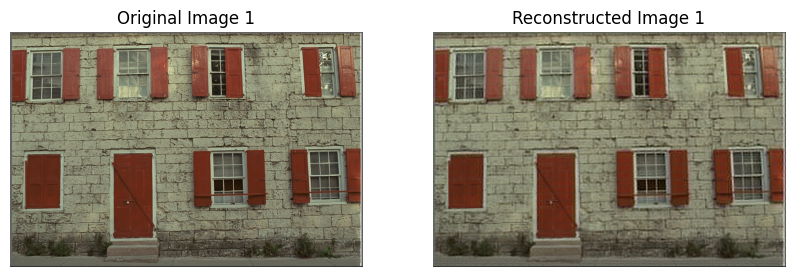

Image 2
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.534422755241394


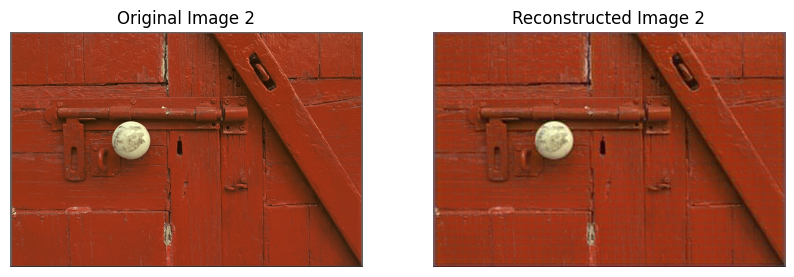

Image 3
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.27909278869628906


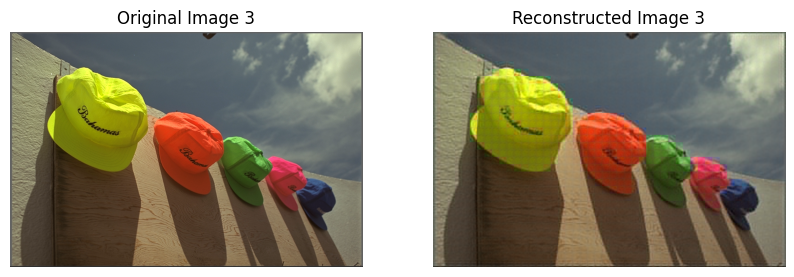

Image 4
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.37903523445129395


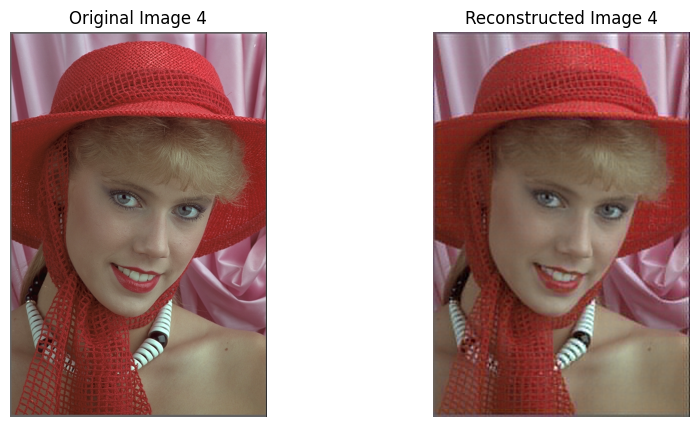

Image 5
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.42344290018081665


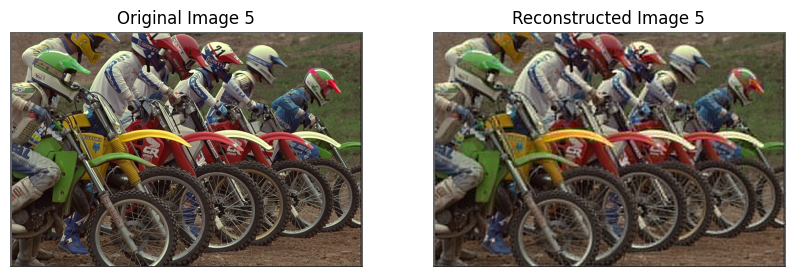

Image 6
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.47358471155166626


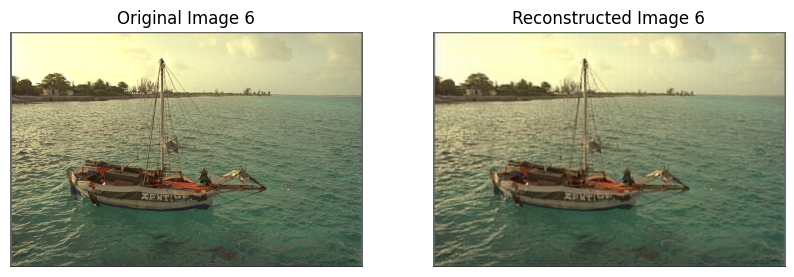

Image 7
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.26106807589530945


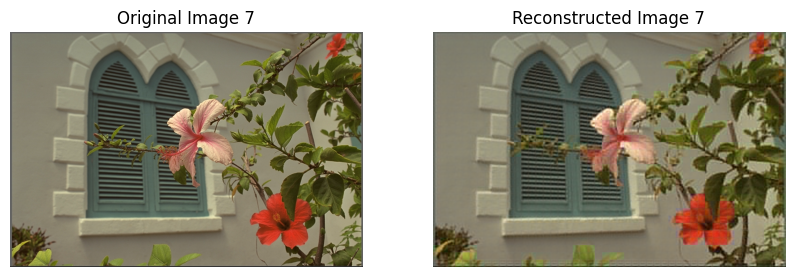

Image 8
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.4228660762310028


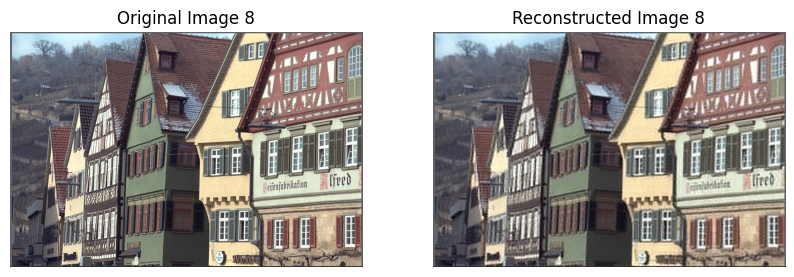

Image 9
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.32949331402778625


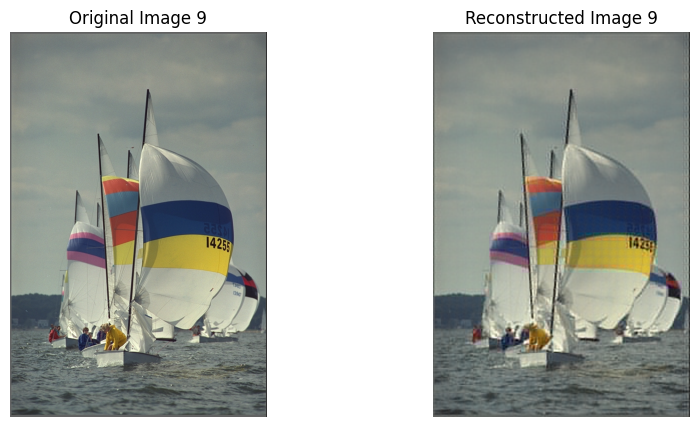

Image 10
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.34799256920814514


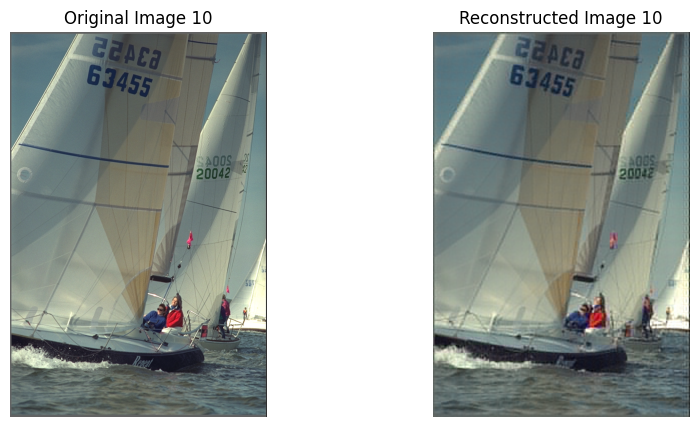

Image 11
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.4366007447242737


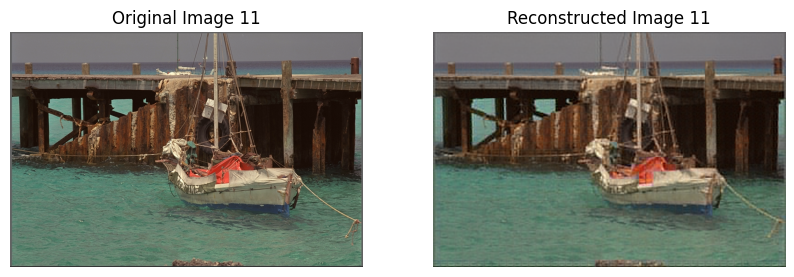

Image 12
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.401737242937088


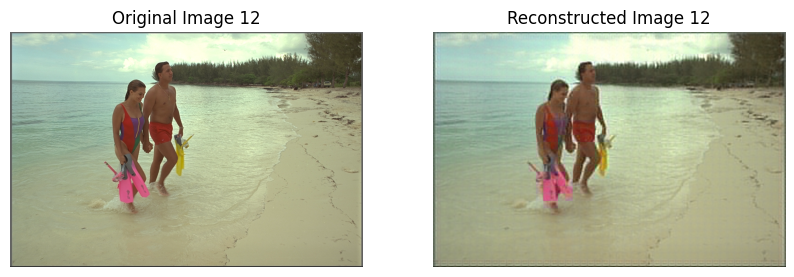

Image 13
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.603298544883728


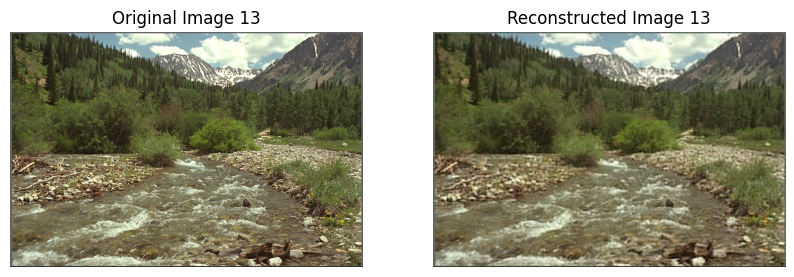

Image 14
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.4736672043800354


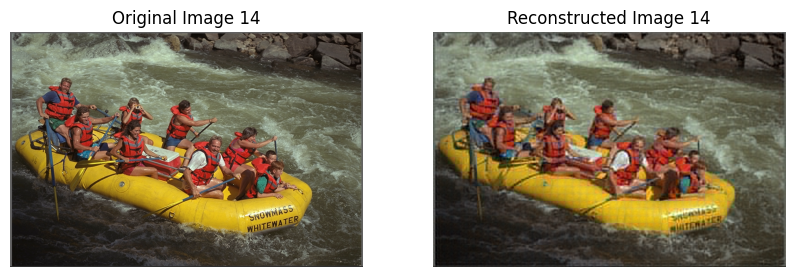

Image 15
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.3582671284675598


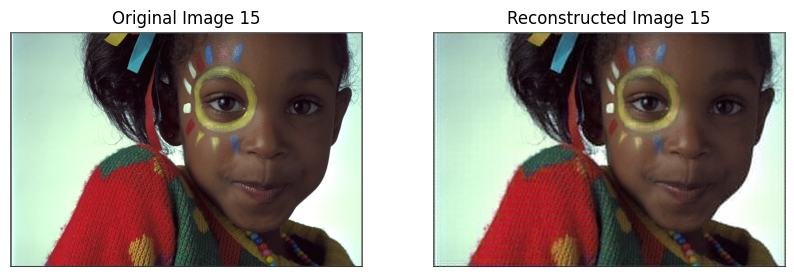

Image 16
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.39886730909347534


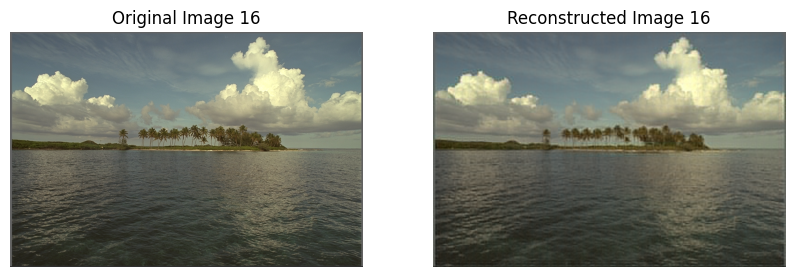

Image 17
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.2946473956108093


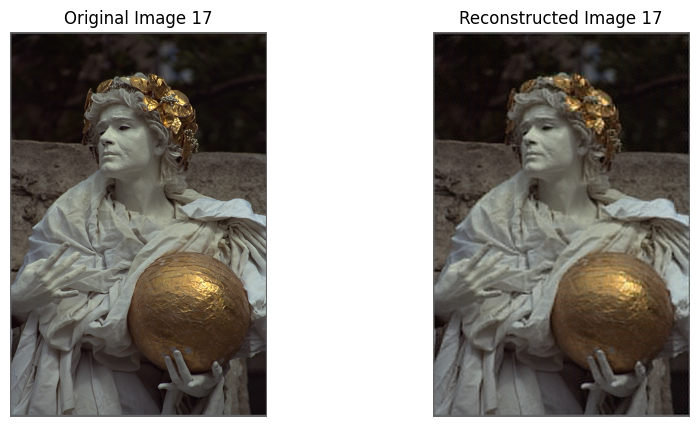

Image 18
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.4120385944843292


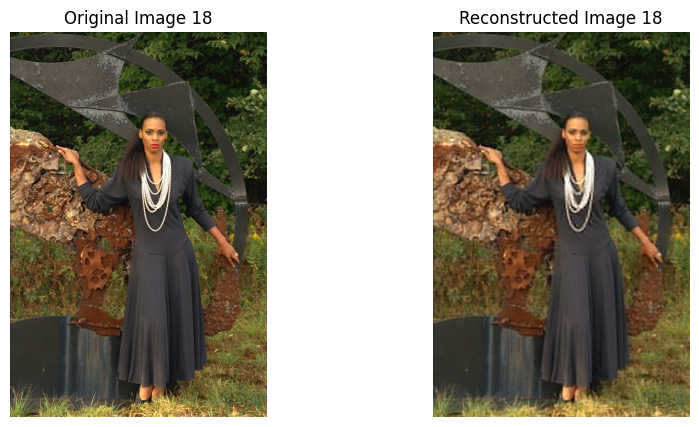

Image 19
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.41413164138793945


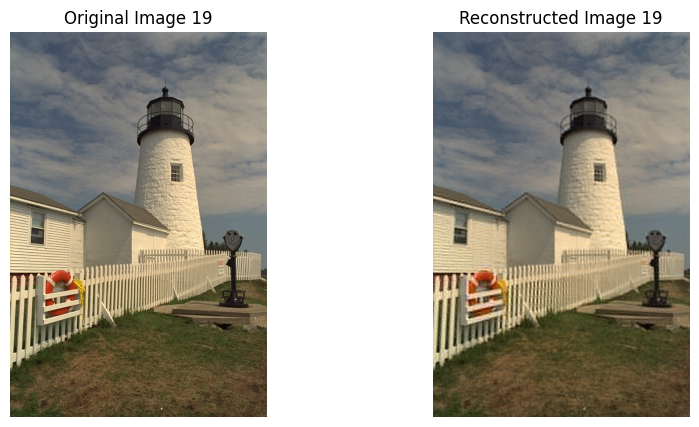

Image 20
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.3262172043323517


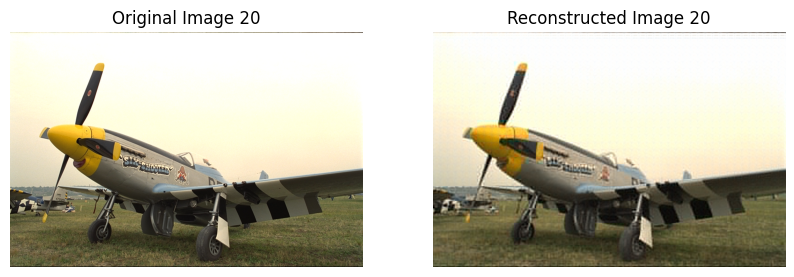

Image 21
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.4366362690925598


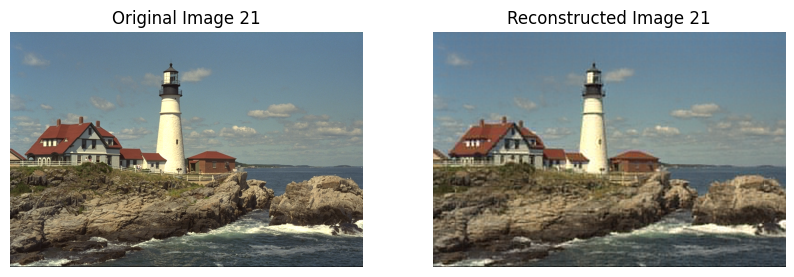

Image 22
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.4207553267478943


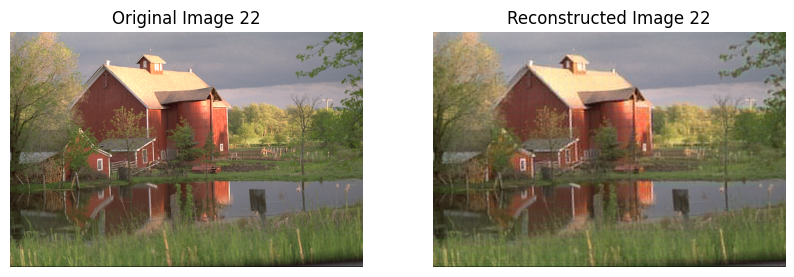

Image 23
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.22737878561019897


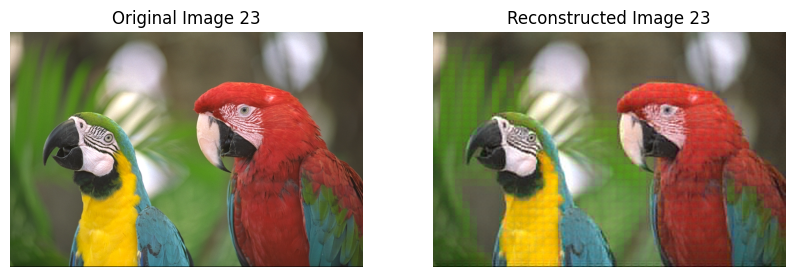

Image 24
Original image size: 4718592 bytes
Compressed image size: 147456 bytes
Compression ratio: 32.0
Bits per pixel (bpp): 3.0
Perceptual similarity (LPIPS): 0.42919009923934937


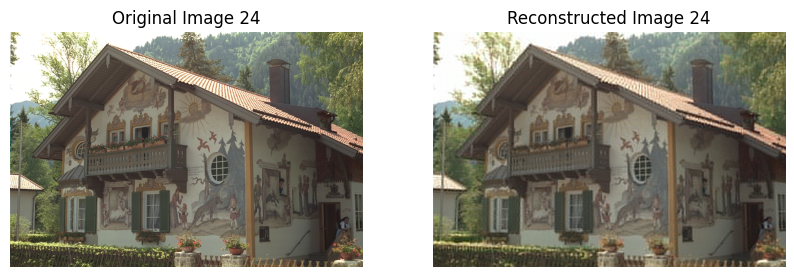

In [ ]:
import torch
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import lpips
def denormalize(tensor):
    mean = torch.tensor([0.5, 0.5, 0.5]).view(1, 3, 1, 1).to(tensor.device)  # Reshape mean to match tensor shape
    std = torch.tensor([0.5, 0.5, 0.5]).view(1, 3, 1, 1).to(tensor.device)   # Reshape std to match tensor shape
    tensor = tensor * std + mean  # Denormalize
    return tensor

def quantize(tensor, num_levels):
    min_val = tensor.min()
    max_val = tensor.max()
    scale = (max_val - min_val) / (num_levels - 1)
    quantized = torch.round((tensor - min_val) / scale)
    return quantized, scale, min_val

def dequantize(quantized, scale, min_val):
    dequantized = quantized * scale + min_val
    return dequantized

def compress_image_batch(images, model, num_levels):
    byte_streams = []
    shapes = []
    scales = []
    min_vals = []

    for image in images:
        with torch.no_grad():
            transformed_image = model.conv1(image)
        quantized_image, scale, min_val = quantize(transformed_image, num_levels)
        flat_quantized = quantized_image.flatten().cpu().numpy()
        byte_stream = flat_quantized.tobytes()

        byte_streams.append(byte_stream)
        shapes.append(quantized_image.shape)
        scales.append(scale)
        min_vals.append(min_val)

    return byte_streams, shapes, scales, min_vals

def decompress_image_batch(byte_streams, shapes, scales, min_vals, model):
    reconstructed_images = []

    for byte_stream, shape, scale, min_val in zip(byte_streams, shapes, scales, min_vals):
        flat_quantized = np.frombuffer(byte_stream, dtype=np.float32)
        quantized_image = torch.tensor(flat_quantized).view(shape).to(model.conv1.weight.device)
        dequantized_image = dequantize(quantized_image, scale, min_val)

        with torch.no_grad():
            reconstructed_image = model.conv2(dequantized_image)

        reconstructed_images.append(reconstructed_image)

    return reconstructed_images

# Load images
def load_images(image_paths):
    images = []
    for path in image_paths:
        image = cv.imread(path)
        image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
        image = torch.from_numpy(image).permute(2, 0, 1).unsqueeze(0).float() / 255.0
        image = (image - 0.5) / 0.5  # Normalize the image
        images.append(image)
    return images

# Example image paths
image_paths = ['/content/image-compression/images/colored/1.png',
               '/content/image-compression/images/colored/2.png',
               '/content/image-compression/images/colored/3.png',
               '/content/image-compression/images/colored/4.png',
               '/content/image-compression/images/colored/5.png',
               '/content/image-compression/images/colored/6.png',
               '/content/image-compression/images/colored/7.png',
               '/content/image-compression/images/colored/8.png',
               '/content/image-compression/images/colored/9.png',
               '/content/image-compression/images/colored/10.png',
               '/content/image-compression/images/colored/11.png',
               '/content/image-compression/images/colored/12.png',
               '/content/image-compression/images/colored/13.png',
               '/content/image-compression/images/colored/14.png',
               '/content/image-compression/images/colored/15.png',
               '/content/image-compression/images/colored/16.png',
               '/content/image-compression/images/colored/17.png',
               '/content/image-compression/images/colored/18.png',
               '/content/image-compression/images/colored/19.png',
               '/content/image-compression/images/colored/20.png',
               '/content/image-compression/images/colored/21.png',
               '/content/image-compression/images/colored/22.png',
               '/content/image-compression/images/colored/23.png',
               '/content/image-compression/images/colored/24.png',
               # Add more paths here
              ]

images = load_images(image_paths)

# Compress and decompress the images
compressed_byte_streams, shapes, scales, min_vals = compress_image_batch(images, model, num_levels=256)
reconstructed_images = decompress_image_batch(compressed_byte_streams, shapes, scales, min_vals, model=model)

# LPIPS Loss function
loss_fn = lpips.LPIPS(net='alex').cuda()

for i in range(len(images)):
    original_image_np = denormalize(images[i]).squeeze().permute(1, 2, 0).cpu().numpy()
    reconstructed_image_np = denormalize(reconstructed_images[i]).squeeze().permute(1, 2, 0).cpu().numpy()

    # Convert tensors for LPIPS
    original_image_for_lpips = images[i].cuda()
    reconstructed_image_for_lpips = reconstructed_images[i].cuda()

    # Calculate LPIPS perceptual similarity
    d = loss_fn.forward(original_image_for_lpips, reconstructed_image_for_lpips)

    # Image size metrics
    original_image_size = images[i].nelement() * images[i].element_size()
    compressed_image_size = len(compressed_byte_streams[i])
    compression_ratio = original_image_size / compressed_image_size
    bpp = (compressed_image_size * 8) / (images[i].shape[2] * images[i].shape[3])

    # Print metrics
    print(f'Image {i+1}')
    print(f'Original image size: {original_image_size} bytes')
    print(f'Compressed image size: {compressed_image_size} bytes')
    print(f'Compression ratio: {compression_ratio}')
    print(f'Bits per pixel (bpp): {bpp}')
    print(f'Perceptual similarity (LPIPS): {d.item()}')

    # Plot images
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title(f'Original Image {i+1}')
    plt.imshow(original_image_np)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title(f'Reconstructed Image {i+1}')
    plt.imshow(reconstructed_image_np)
    plt.axis('off')

    plt.show()